# 准备数据

In [1]:
# 过滤Alphalens的warning
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [2]:
# 加载模块
import polars as pl

from vnpy.trader.constant import Interval

from vnpy.alpha import AlphaLab

In [3]:
# 创建数据中心
lab: AlphaLab = AlphaLab("./lab/csi300")

In [4]:
# 设置任务参数
name = "300_lgb"
index_symbol: str = "000300.SSE"
start: str = "2008-01-01"
end: str = "2023-12-31"
interval: Interval = Interval.DAILY
extended_days: int = 100

In [5]:
# 加载所有成分股代码
component_symbols: list[str] = lab.load_component_symbols(index_symbol, start, end)

# 特征计算

In [6]:
# 加载模块
from functools import partial

from vnpy.trader.constant import Interval

from vnpy.alpha.dataset import (
    AlphaDataset,
    process_drop_na,
    process_cs_norm
)
from vnpy.alpha.dataset.datasets.alpha_101 import Alpha101

In [7]:
# 加载成分股数据
df: pl.DataFrame = lab.load_bar_df(component_symbols, interval, start, end, extended_days)

In [8]:
df

datetime,open,high,low,close,volume,turnover,open_interest,vwap,vt_symbol
datetime[μs],f64,f64,f64,f64,f64,f64,f64,f64,str
2018-01-15 00:00:00,0.833333,1.0,0.833333,1.0,60793.18508,927238.8,0.0,15.252348,"""002925.SZSE"""
2018-01-16 00:00:00,1.1,1.1,1.1,1.1,25659.43388,434166.48,0.0,16.920345,"""002925.SZSE"""
2018-01-17 00:00:00,1.209877,1.209877,1.209877,1.209877,49288.356,917280.0,0.0,18.610481,"""002925.SZSE"""
2018-01-18 00:00:00,1.330864,1.330864,1.330864,1.330864,60917.45914,1.2471e6,0.0,20.471529,"""002925.SZSE"""
2018-01-19 00:00:00,1.463889,1.463889,1.463889,1.463889,294763.32594,6.6374e6,0.0,22.517732,"""002925.SZSE"""
…,…,…,…,…,…,…,…,…,…
2024-01-04 00:00:00,1.180777,1.181754,1.166115,1.174912,5.2635e6,5.8869681e7,0.0,11.184515,"""600598.SSE"""
2024-01-05 00:00:00,1.176867,1.176867,1.163182,1.167092,5.7647e6,6.4248843e7,0.0,11.145273,"""600598.SSE"""
2024-01-08 00:00:00,1.165137,1.16807,1.140701,1.141678,7.2300e6,7.9203011e7,0.0,10.954741,"""600598.SSE"""


In [9]:
# 创建数据集对象
dataset: AlphaDataset = Alpha101(
    df,
    train_period = ("2008-01-01", "2014-12-31"),
    valid_period = ("2015-01-01", "2016-12-31"),
    test_period = ("2017-01-01", "2020-8-31"),
)

In [10]:
# 添加数据预处理器
dataset.add_processor("learn", partial(process_drop_na, names=["label"]))
dataset.add_processor("learn", partial(process_cs_norm, names=["label"], method="zscore"))

In [11]:
# 收集指数成分过滤器
filters: dict[str, list[str]] = lab.load_component_filters(index_symbol, start, end)

In [12]:
# 准备特征和标签数据
dataset.prepare_data(filters, max_workers=10)

2025-12-04 13:47:28 开始计算表达式因子特征


100%|████████████████████████████████████████████████████████| 83/83 [58:22<00:00, 42.20s/it]


2025-12-04 14:45:52 开始合并结果数据因子特征


0it [00:00, ?it/s]


2025-12-04 14:45:53 开始筛选成分股数据


100%|█████████████████████████████████████████████████████| 819/819 [00:03<00:00, 205.67it/s]


Dropped 0.3% entries from factor data: 0.3% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,77.530,1408.045,851.106091,194.417775,87347,10.119609
2,623.565,1702.670,1149.841061,162.933831,86436,10.014065
3,818.235,1886.285,1330.861048,178.341061,85794,9.939686
4,971.790,2082.225,1485.932456,193.957910,86244,9.991821
5,1093.920,2247.165,1632.957235,209.362400,86405,10.010473
6,1219.900,2433.560,1776.470360,224.301613,85661,9.924277
7,1302.305,2651.165,1920.256806,239.555494,85811,9.941655
8,1432.140,2863.655,2073.325692,257.728681,86227,9.989851
9,1538.355,3165.920,2251.550755,280.604031,85998,9.963320


Returns Analysis


,1D,5D,10D
Ann. alpha,0.023,0.056,0.041
beta,-0.012,-0.023,-0.028
Mean Period Wise Return Top Quantile (bps),2.334,3.302,2.070
Mean Period Wise Return Bottom Quantile (bps),-0.657,-2.808,-2.080
Mean Period Wise Spread (bps),2.991,6.105,4.143


<Figure size 640x480 with 0 Axes>

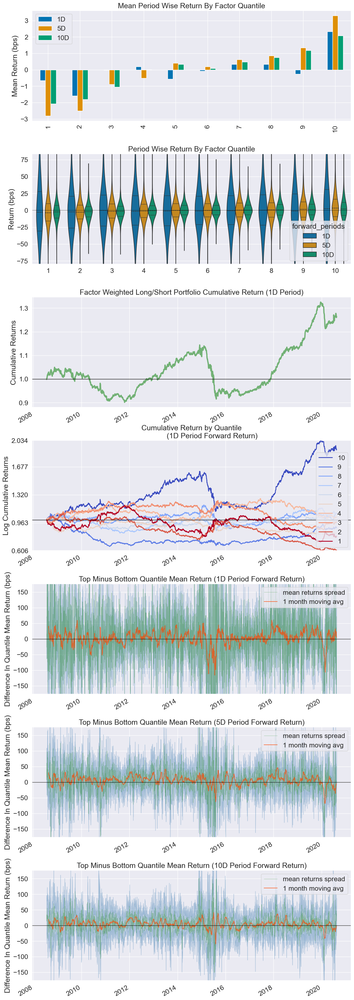

Information Analysis


,1D,5D,10D
IC Mean,0.008,0.025,0.024
IC Std.,0.111,0.111,0.112
Risk-Adjusted IC,0.075,0.222,0.215
t-stat(IC),4.086,12.042,11.652
p-value(IC),0.000,0.000,0.000
IC Skew,-0.040,-0.242,-0.209
IC Kurtosis,0.711,0.753,0.865


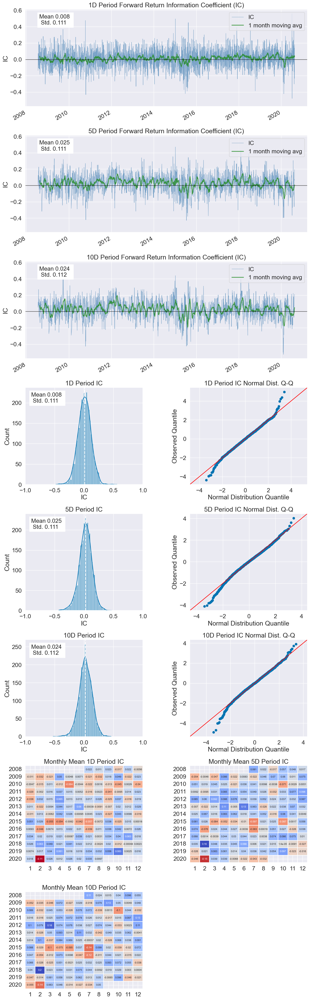

C:\Users\xiaohe\Miniconda3\envs\313\Lib\site-packages\alphalens\utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,10D
Quantile 1 Mean Turnover,0.605,0.771,0.849
Quantile 2 Mean Turnover,0.771,0.841,0.877
Quantile 3 Mean Turnover,0.817,0.871,0.889
Quantile 4 Mean Turnover,0.835,0.882,0.895
Quantile 5 Mean Turnover,0.846,0.887,0.898
Quantile 6 Mean Turnover,0.846,0.888,0.897
Quantile 7 Mean Turnover,0.837,0.883,0.894
Quantile 8 Mean Turnover,0.813,0.868,0.888
Quantile 9 Mean Turnover,0.771,0.843,0.875
Quantile 10 Mean Turnover,0.584,0.772,0.845


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.683,0.376,0.167


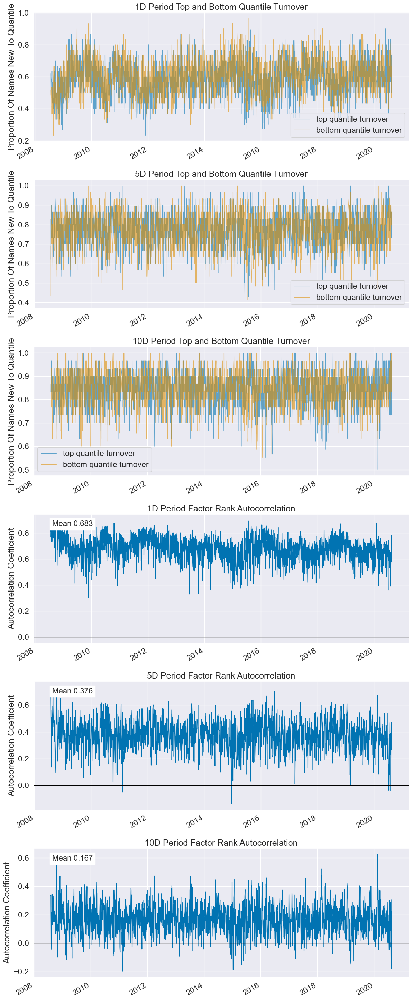

In [13]:
# 特征表现分析
dataset.show_feature_performance("alpha36")

In [14]:
# 数据预处理
dataset.process_data()

In [15]:
# 保存到文件缓存
lab.save_dataset(name, dataset)

# 模型训练

In [16]:
# 加载模块
import numpy as np

from vnpy.alpha import Segment, AlphaDataset, AlphaModel

from vnpy.alpha.model.models.lgb_model import LgbModel

In [17]:
# 从文件缓存加载
dataset: AlphaDataset = lab.load_dataset(name)

In [18]:
# 创建模型对象
model: AlphaModel = LgbModel(seed=42)

In [19]:
# 使用数据集训练模型
model.fit(dataset)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.122433 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16328
[LightGBM] [Info] Number of data points in the train set: 510579, number of used features: 80
[LightGBM] [Info] Start training from score -0.000000
[1]	train's l2: 0.995579	valid's l2: 0.996085
Training until validation scores don't improve for 50 rounds
[2]	train's l2: 0.994533	valid's l2: 0.995948
[3]	train's l2: 0.993671	valid's l2: 0.995758
[4]	train's l2: 0.99271	valid's l2: 0.995315
[5]	train's l2: 0.991912	valid's l2: 0.99515
[6]	train's l2: 0.991205	valid's l2: 0.99502
[7]	train's l2: 0.990571	valid's l2: 0.994938
[8]	train's l2: 0.990017	valid's l2: 0.99481
[9]	train's l2: 0.989416	valid's l2: 0.994737
[10]	train's l2: 0.988846	valid's l2: 0.994567
[11]	train's l2: 0.988302	valid's l2: 0.994497
[12]	train's l2: 0.987725	valid's l2: 0.994586
[13]	train's l2: 0.987228	valid's l2: 0.994

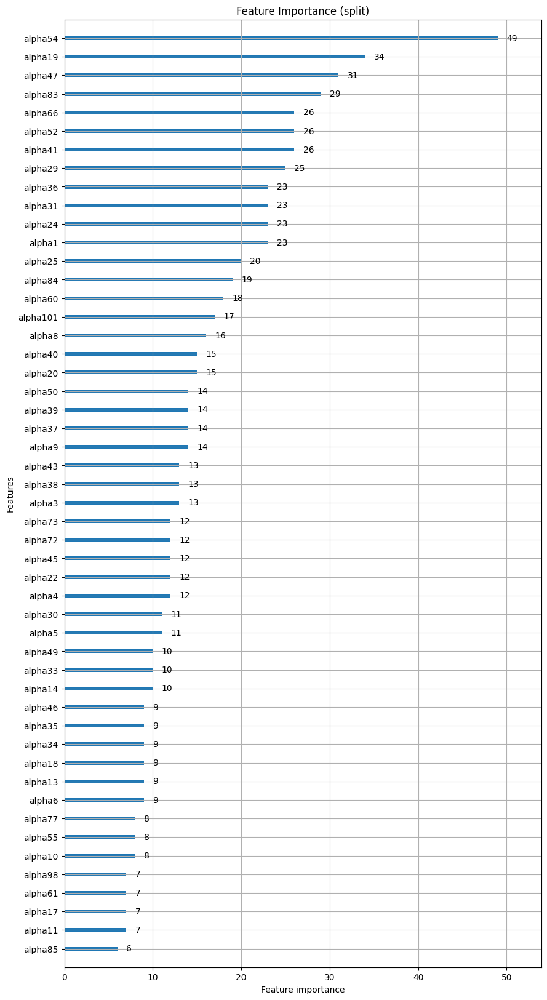

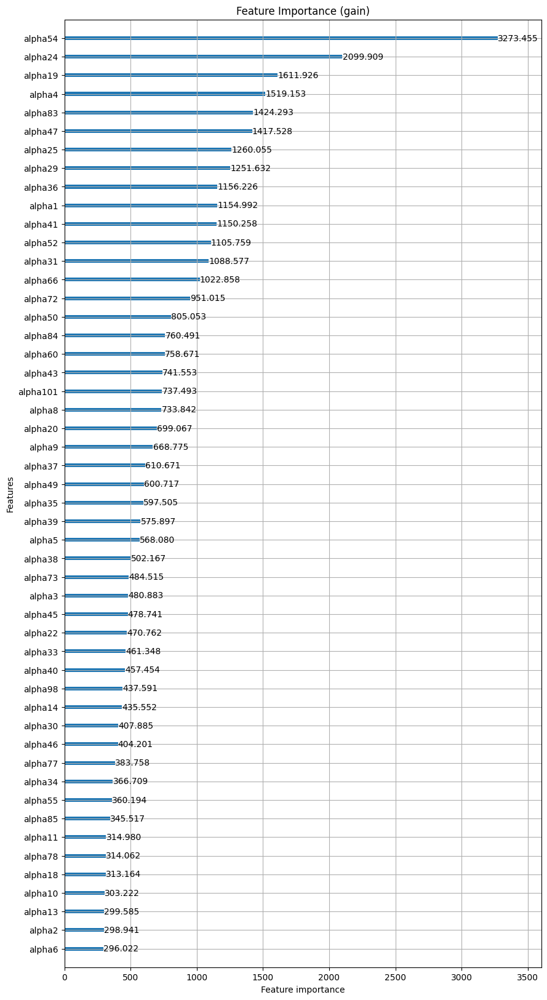

In [20]:
# 查看模型细节
model.detail()

In [21]:
# 保存模型
lab.save_model(name, model)

# 预测信号

In [22]:
model: AlphaModel = lab.load_model(name)

In [23]:
# 用模型在测试集上预测
pre: np.ndarray = model.predict(dataset, Segment.TEST)

# 加载测试集数据
df_t: pl.DataFrame = dataset.fetch_infer(Segment.TEST)

# 合并预测信号列
df_t = df_t.with_columns(pl.Series(pre).alias("signal"))

# 提取信号数据
signal: pl.DataFrame = df_t["datetime", "vt_symbol", "signal"]

Dropped 1.1% entries from factor data: 1.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 100.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-2.862359,-0.006479,-0.132822,0.093856,26463,10.001134
2,-0.508472,0.013745,-0.058668,0.023844,26458,9.999244
3,-0.289437,0.032701,-0.030824,0.016793,26459,9.999622
4,-0.088871,0.051979,-0.013607,0.013811,26461,10.000378
5,-0.041386,0.069883,-0.000368,0.013506,26459,9.999622
6,-0.026142,0.104246,0.011821,0.014872,26460,10.000000
7,-0.012871,0.135977,0.025239,0.017949,26461,10.000378
8,0.001653,0.204317,0.042938,0.023771,26460,10.000000
9,0.012461,0.271191,0.072035,0.036121,26459,9.999622


Returns Analysis


,1D,5D,10D
Ann. alpha,0.546,0.271,0.144
beta,0.046,0.036,-0.001
Mean Period Wise Return Top Quantile (bps),16.834,10.259,6.845
Mean Period Wise Return Bottom Quantile (bps),-15.194,-8.332,-3.277
Mean Period Wise Spread (bps),32.028,18.607,10.147


<Figure size 640x480 with 0 Axes>

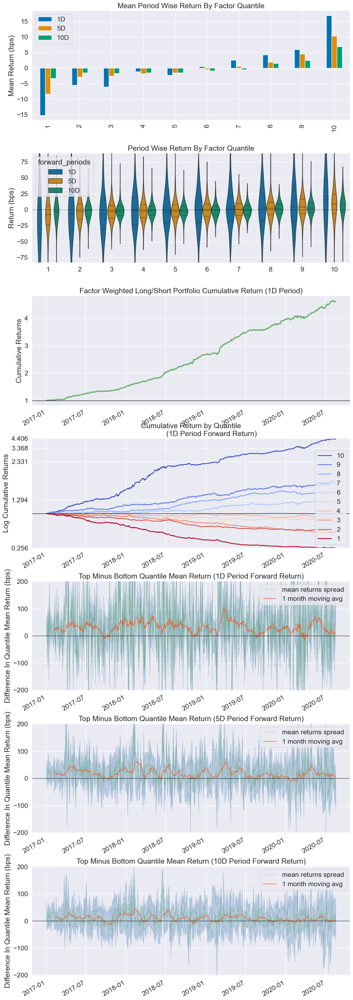

Information Analysis


,1D,5D,10D
IC Mean,0.063,0.058,0.046
IC Std.,0.129,0.121,0.117
Risk-Adjusted IC,0.491,0.482,0.394
t-stat(IC),14.595,14.309,11.704
p-value(IC),0.000,0.000,0.000
IC Skew,0.055,0.132,0.068
IC Kurtosis,0.283,-0.211,-0.172


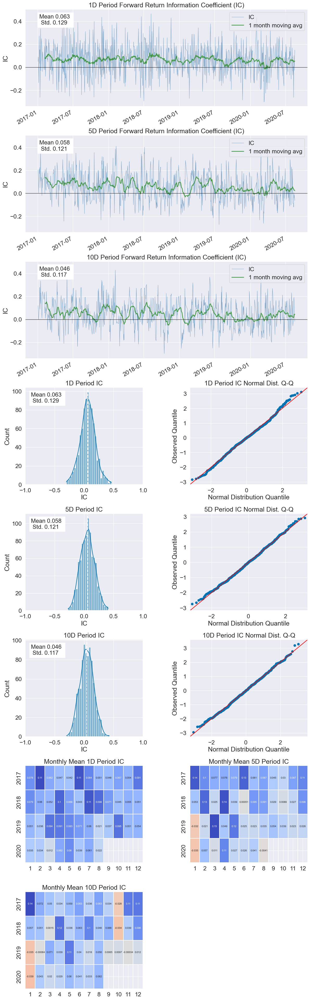

C:\Users\xiaohe\Miniconda3\envs\313\Lib\site-packages\alphalens\utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,10D
Quantile 1 Mean Turnover,0.650,0.816,0.827
Quantile 2 Mean Turnover,0.815,0.883,0.887
Quantile 3 Mean Turnover,0.840,0.876,0.884
Quantile 4 Mean Turnover,0.844,0.868,0.876
Quantile 5 Mean Turnover,0.846,0.868,0.874
Quantile 6 Mean Turnover,0.841,0.876,0.874
Quantile 7 Mean Turnover,0.840,0.880,0.885
Quantile 8 Mean Turnover,0.820,0.875,0.883
Quantile 9 Mean Turnover,0.759,0.856,0.866
Quantile 10 Mean Turnover,0.563,0.765,0.789


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.435,0.112,0.087


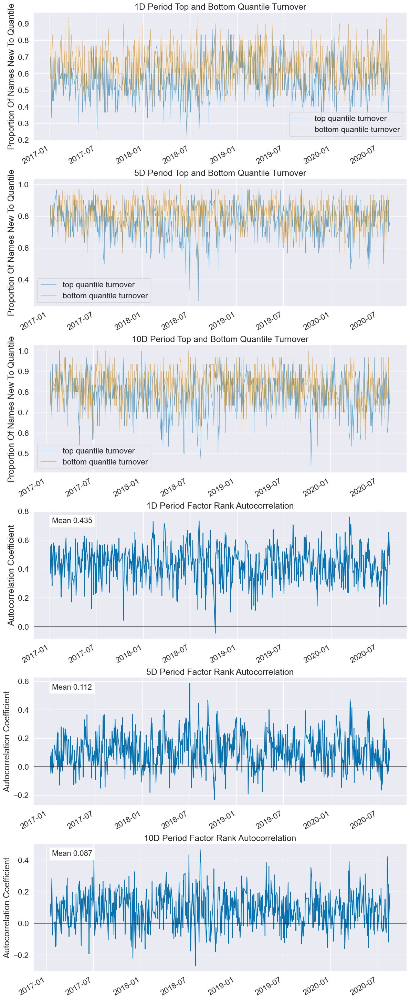

In [24]:
# 检查信号绩效
dataset.show_signal_performance(signal)

In [25]:
# 保存信号数据
lab.save_signal(name, signal)

# 策略回测

In [26]:
# 加载模块
import importlib
from datetime import datetime

from vnpy.alpha.strategy import BacktestingEngine

import vnpy.alpha.strategy.strategies.equity_demo_strategy as equity_demo_strategy

In [27]:
# 重载策略类
importlib.reload(equity_demo_strategy)
EquityDemoStrategy = equity_demo_strategy.EquityDemoStrategy

In [28]:
# 从文件加载信号数据
signal = lab.load_signal(name)

In [29]:
# 创建回测引擎对象
engine = BacktestingEngine(lab)

# 设置回测参数
engine.set_parameters(
    vt_symbols=component_symbols,
    interval=Interval.DAILY,
    start=datetime(2017, 1, 1),
    end=datetime(2020, 8, 1),
    capital=100000000
)

# 添加策略实例
setting = {"top_k": 30, "n_drop": 3, "hold_thresh": 3}
engine.add_strategy(EquityDemoStrategy, setting, signal)

In [30]:
# 执行回测任务
engine.load_data()
engine.run_backtesting()
engine.calculate_result()
engine.calculate_statistics()
engine.show_chart()

2025-12-04 14:47:24 开始加载历史数据


100%|█████████████████████████████████████████████████████| 819/819 [00:05<00:00, 153.63it/s]

2025-12-04 14:47:30 部分合约历史数据为空：['601299.SSE', '600087.SSE', '600905.SSE', '601728.SSE', '000527.SZSE', '601995.SSE', '601268.SSE', '605499.SSE', '688187.SSE', '688303.SSE', '600102.SSE', '000024.SZSE', '688041.SSE', '600631.SSE', '300957.SZSE', '600786.SSE', '300866.SZSE', '605117.SSE', '600001.SSE', '600938.SSE', '600941.SSE', '688065.SSE', '301269.SZSE', '600591.SSE', '601825.SSE', '300919.SZSE', '600832.SSE', '000562.SZSE', '001289.SZSE', '600357.SSE', '601868.SSE', '300888.SZSE', '601059.SSE', '300896.SZSE', '688271.SSE', '300999.SZSE', '300979.SZSE', '688223.SSE']
2025-12-04 14:47:30 所有历史数据加载完成
2025-12-04 14:47:30 策略初始化完成
2025-12-04 14:47:30 开始回放历史数据


2025-12-04 14:47:34 历史数据回放结束
2025-12-04 14:47:34 开始计算逐日盯市盈亏
2025-12-04 14:47:35 逐日盯市盈亏计算完成
2025-12-04 14:47:35 开始计算策略统计指标
2025-12-04 14:47:35 ------------------------------
2025-12-04 14:47:35 首个交易日：  2017-01-03
2025-12-04 14:47:35 最后交易日：  2020-07-31
2025-12-04 14:47:35 总交易日：  871
2025-12-04 14:47:35 盈利交易日：  462
2025-12-04 14:47:35 亏损交易日：  408
2025-12-04 14:47:35 起始资金：  100,000,000.00
2025-12-04 14:47:35 结束资金：  241,409,782.23
2025-12-04 14:47:35 总收益率：  141.41%
2025-12-04 14:47:35 年化收益：  38.96%
2025-12-04 14:47:35 最大回撤:   -44,098,894.14
2025-12-04 14:47:35 百分比最大回撤: -22.78%
2025-12-04 14:47:35 最长回撤天数:   31
2025-12-04 14:47:35 总盈亏：  141,409,782.23
2025-12-04 14:47:35 总手续费：  16,087,069.67
2025-12-04 14:47:35 总成交金额：  21,476,953,592.31
2025-12-04 14:47:35 总成交笔数：  4337
2025-12-04 14:47:35 日均盈亏：  162,353.37
2025-12-04 14:47:35 日均手续费：  18,469.66
2025-12-04 14:47:35 日均成交金额：  24,657,811.24
2025-12-04 14:47:35 日均成交笔数：  4.979334098737084
2025-12-04 14:47:35 日均收益率：  0.11%
2025-12-04 14:47:35 收益标准差： 

In [31]:
# 显示超额收益分析结果
engine.show_performance(benchmark_symbol=index_symbol)